# Multi-Class Prediction of Obesity Risk

# `?` Domain Knowledge

About Dataset:</br>

By the Publisher:

The dataset (both train and test) was generated from a deep learning model trained on the Obesity or CVD risk dataset. Feature distributions are close to, but not exactly the same, as the original.

This notebook delves into the intricate relationship between lifestyle choices and weight management. By meticulously analyzing a of 'Multi-Class Prediction of Obesity Risk' data, we aim to unravel the key factors contributing to weight gain.</br>

Initially, we meticulously curated the data, ensuring its accuracy and reliability for analysis. Subsequently, through comprehensive data examination, we identified noteworthy patterns, such as the correlation between exercise frequency, vegetable consumption, and weight maintenance. Additionally, we scrutinized the potential impact of excessive screen time and unhealthy dietary habits on weight management.</br>

Ultimately, our findings underscored the importance of adopting a balanced lifestyle characterized by increased physical activity, a diet rich in greens, and reduced screen exposure. By shedding light on these factors, our work serves as a valuable resource for individuals seeking effective strategies to promote overall health and prevent weight gain.

| Column Name                     | Description                                                                                                               |
|---------------------------------|---------------------------------------------------------------------------------------------------------------------------|
| id                              | Person ID (Categorical)                                                                                                 |
| Gender                          | person's Gender                                                                  |
| Age                             | Age is between 14 years to 61 years (Dtype is float)    |
| Height                          | Height in meter it's between 1.45m to 1.98m                                                                                 |
| Weight                          | Weight is between 39 to 165 (KG)                                                                                  |
| family_history_with_overweight  | yes or no question, to see if person has family history with overweight                                     |
| FAVC                           | <span style="color:skyblue">'Frequent consumption of high calorie food'</span> it's yes or no question to see if person eats high calorie food frequently |
| FCVC                            | <span style="color:skyblue">'Frequency of consumption of vegetables'</span> Similar to FAVC but with vegetables.(1-3 scale)question |
| NCP                             | <span style="color:skyblue">'Number of main meals'</span> NCP is between 1 & 4 (float), it should be binned to 1,2,3 |
| CAEC                            | <span style="color:skyblue">'Consumption of food between meals'</span> takes 4 values Sometimes, Frequently, no & Always |
| SMOKE                           | "Do you smoke?", yes or no question                                                                 |
| CH2O                            | <span style="color:skyblue">'Consumption of water daily'</span> CH2O takes values between 1 & 3 (float), it's values should be 1,2 or 3            |
| SCC                             | <span style="color:skyblue">'Calories consumption monitoring'</span> "Do you monitor your calories consumption?", yes or no question  |
| FAF                             | <span style="color:skyblue">'Physical activity frequency'</span> FAF is between 0 to 3 (float), 0 means no physical activity and 3 means high workout, needs to be encoding to 0,1,2,3 |
| TUE                             | <span style="color:skyblue">'Time using technology devices'</span> TUE is between 0 to 2 (float). I think question will be "How long you have been using technology devices to track your health.", needs to be binned to 0,1,2 |
| CALC                            | <span style="color:skyblue">'Consumption of alcohol'</span> Takes 3 values: Sometimes, no, Frequently            |
| MTRANS                          | <span style="color:skyblue">'Transportation used'</span> MTRANS takes 5 values Public_Transportation, Automobile, Walking, Motorbike, & Bike |
| NObeyesdad                      | <span style="color:skyblue">'TARGET'</span> This is our target, takes 7 values |

- NObeyesdad (Target):
    - Insufficient_Weight : Less than 18.5
    - Normal_Weight : 18.5 to 24.9
    - Obesity_Type_I : 30.0 to 34.9
    - Obesity_Type_II : 35.0 to 39.9
    - Obesity_Type_III : Higher than 40
    - Overweight_Level_I, Overweight_Level_II takes values between 25 to 29

# `01` Import Libraries

In [2]:
# Import NumPy library for numerical operations
import numpy as np

# Import Pandas library for data manipulation and analysis
import pandas as pd

# Import ydata_profiling library for creating profile reports from a Pandas DataFrame
from ydata_profiling import ProfileReport

import warnings
warnings.filterwarnings("ignore")

# Import Matplotlib library for basic plotting
%matplotlib inline
import matplotlib.pyplot as plt

# Import Seaborn library for statistical data visualization
import seaborn as sns

# Import Seaborn library for statistical data visualization
import seaborn as sns

# Import Plotly Express for creating interactive visualizations
import plotly.express as px

# Import Plotly Graph Objects for more fine-grained control over visualizations
import plotly.graph_objects as go

# Import make_subplots for creating subplots in Plotly
from plotly.subplots import make_subplots

# Import plotly.figure_factory for creating various complex charts and figures
import plotly.figure_factory as ff

In [5]:
# Importing SimpleImputer for handling missing values
from sklearn.impute import SimpleImputer
# Importing DecisionTreeClassifier for classification tasks
from sklearn.tree import DecisionTreeClassifier  
# Importing RandomForestClassifier
from sklearn.ensemble import RandomForestClassifier
# Importing Light Gradient Boosting Machine Classifier
from lightgbm import LGBMClassifier
# Importing preprocessing tools
from sklearn.preprocessing import OneHotEncoder, StandardScaler, FunctionTransformer, LabelEncoder  
# Importing ColumnTransformer for applying different transformations to different columns, and make_column_selector for selecting columns by data type or pattern
from sklearn.compose import ColumnTransformer, make_column_selector 
# Importing make_pipeline for creating pipelines for model building and Pipeline for chaining multiple estimators
from sklearn.pipeline import make_pipeline, Pipeline 
# Importing TSNE for t-Distributed Stochastic Neighbor Embedding for dimensionality reduction
from sklearn.manifold import TSNE 
# Importing confusion_matrix for evaluating classification performance
from sklearn.metrics import confusion_matrix, classification_report, make_scorer, accuracy_score
# Importing cross_val_predict for cross-validated predictions
from sklearn.model_selection import StratifiedKFold, cross_val_predict, cross_validate, train_test_split
# feature selection
from sklearn.feature_selection import mutual_info_classif
# Import KMeans for clustering
from sklearn.cluster import KMeans
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.base import BaseEstimator, TransformerMixin

# 
# from lightgbm import LGBMClassifier, plot_importance
# Score
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,ConfusionMatrixDisplay,f1_score
# importing plotly
import optuna
from optuna.samplers import TPESampler
from sklearn.model_selection import cross_val_score

# `02` Load Data

Note: Make sure the `Data` folder attached with the notebook is in the same path for this cell to work properly.

[Dataset Link](https://www.kaggle.com/competitions/playground-series-s4e2/data)

In [6]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

----------------

# `03` Exploratory Data Analysis (EDA)

In [7]:
df_train = train.copy()

In [8]:
profile =  ProfileReport(df_train, title='Pandas Profiling Report')

# display the report
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
df_train.head()

,id,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
0,0,Male,24.443011,1.699998,81.669950,yes,yes,2.000000,2.983297,Sometimes,no,2.763573,no,0.000000,0.976473,Sometimes,Public_Transportation,Overweight_Level_II
1,1,Female,18.000000,1.560000,57.000000,yes,yes,2.000000,3.000000,Frequently,no,2.000000,no,1.000000,1.000000,no,Automobile,Normal_Weight
2,2,Female,18.000000,1.711460,50.165754,yes,yes,1.880534,1.411685,Sometimes,no,1.910378,no,0.866045,1.673584,no,Public_Transportation,Insufficient_Weight
3,3,Female,20.952737,1.710730,131.274851,yes,yes,3.000000,3.000000,Sometimes,no,1.674061,no,1.467863,0.780199,Sometimes,Public_Transportation,Obesity_Type_III
4,4,Male,31.641081,1.914186,93.798055,yes,yes,2.679664,1.971472,Sometimes,no,1.979848,no,1.967973,0.931721,Sometimes,Public_Transportation,Overweight_Level_II


In [9]:
df_train.shape

(20758, 18)

In [10]:
df_train.columns

Index(['id', 'Gender', 'Age', 'Height', 'Weight',
       'family_history_with_overweight', 'FAVC', 'FCVC', 'NCP', 'CAEC',
       'SMOKE', 'CH2O', 'SCC', 'FAF', 'TUE', 'CALC', 'MTRANS', 'NObeyesdad'],
      dtype='object')

In [11]:
df_train.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20758 entries, 0 to 20757
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              20758 non-null  int64  
 1   Gender                          20758 non-null  object 
 2   Age                             20758 non-null  float64
 3   Height                          20758 non-null  float64
 4   Weight                          20758 non-null  float64
 5   family_history_with_overweight  20758 non-null  object 
 6   FAVC                            20758 non-null  object 
 7   FCVC                            20758 non-null  float64
 8   NCP                             20758 non-null  float64
 9   CAEC                            20758 non-null  object 
 10  SMOKE                           20758 non-null  object 
 11  CH2O                            20758 non-null  float64
 12  SCC                             

In [12]:
df_train.select_dtypes('number').info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20758 entries, 0 to 20757
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      20758 non-null  int64  
 1   Age     20758 non-null  float64
 2   Height  20758 non-null  float64
 3   Weight  20758 non-null  float64
 4   FCVC    20758 non-null  float64
 5   NCP     20758 non-null  float64
 6   CH2O    20758 non-null  float64
 7   FAF     20758 non-null  float64
 8   TUE     20758 non-null  float64
dtypes: float64(8), int64(1)
memory usage: 1.4 MB


In [11]:
df_train.select_dtypes('O').info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20758 entries, 0 to 20757
Data columns (total 9 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   Gender                          20758 non-null  object
 1   family_history_with_overweight  20758 non-null  object
 2   FAVC                            20758 non-null  object
 3   CAEC                            20758 non-null  object
 4   SMOKE                           20758 non-null  object
 5   SCC                             20758 non-null  object
 6   CALC                            20758 non-null  object
 7   MTRANS                          20758 non-null  object
 8   NObeyesdad                      20758 non-null  object
dtypes: object(9)
memory usage: 1.4+ MB


In [12]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
id,20758.0,10378.500000,5992.462780,0.00,5189.250000,10378.500000,15567.750000,20757.000000
Age,20758.0,23.841804,5.688072,14.00,20.000000,22.815416,26.000000,61.000000
Height,20758.0,1.700245,0.087312,1.45,1.631856,1.700000,1.762887,1.975663
Weight,20758.0,87.887768,26.379443,39.00,66.000000,84.064875,111.600553,165.057269
FCVC,20758.0,2.445908,0.533218,1.00,2.000000,2.393837,3.000000,3.000000
NCP,20758.0,2.761332,0.705375,1.00,3.000000,3.000000,3.000000,4.000000
CH2O,20758.0,2.029418,0.608467,1.00,1.792022,2.000000,2.549617,3.000000
FAF,20758.0,0.981747,0.838302,0.00,0.008013,1.000000,1.587406,3.000000
TUE,20758.0,0.616756,0.602113,0.00,0.000000,0.573887,1.000000,2.000000


In [13]:
df_train.isna().sum().sort_values()

id                                0
CALC                              0
TUE                               0
FAF                               0
SCC                               0
CH2O                              0
SMOKE                             0
CAEC                              0
NCP                               0
FCVC                              0
FAVC                              0
family_history_with_overweight    0
Weight                            0
Height                            0
Age                               0
Gender                            0
MTRANS                            0
NObeyesdad                        0
dtype: int64

In [16]:
#create a copy to drop id and chedck duplicate
copy_t= train.copy()
copy_t.drop(['id'], axis=1)
copy_t.duplicated().sum()

0

- There are no missing or duplicate values in any of the columns.

In [17]:
df_train.nunique()

id                                20758
Gender                                2
Age                                1703
Height                             1833
Weight                             1979
family_history_with_overweight        2
FAVC                                  2
FCVC                                934
NCP                                 689
CAEC                                  4
SMOKE                                 2
CH2O                               1506
SCC                                   2
FAF                                1360
TUE                                1297
CALC                                  3
MTRANS                                5
NObeyesdad                            7
dtype: int64

In [18]:
num_col = df_train.describe(include='number').columns
num_col

Index(['id', 'Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE'], dtype='object')

In [19]:
for col in num_col:
    print(f'Column Name: {col}')
    print('**'*18)
    print("Max: ", df_train[col].max())
    print("Min: ", df_train[col].min())
    print(df_train[col].value_counts(normalize=True, ascending=True))    # Display the value counts for each unique value in the current column
    print('END', '--'*18, '\n')

Column Name: id
************************************
Max:  20757
Min:  0
id
0        0.000048
13843    0.000048
13842    0.000048
13841    0.000048
13840    0.000048
           ...   
6915     0.000048
6914     0.000048
6913     0.000048
6931     0.000048
20757    0.000048
Name: proportion, Length: 20758, dtype: float64
END ------------------------------------ 

Column Name: Age
************************************
Max:  61.0
Min:  14.0
Age
24.754302    0.000048
18.137495    0.000048
29.725222    0.000048
23.165574    0.000048
18.137820    0.000048
               ...   
19.000000    0.042682
23.000000    0.057905
21.000000    0.079150
26.000000    0.087003
18.000000    0.092302
Name: proportion, Length: 1703, dtype: float64
END ------------------------------------ 

Column Name: Height
************************************
Max:  1.975663
Min:  1.45
Height
1.536819    0.000048
1.725625    0.000048
1.817271    0.000048
1.695469    0.000048
1.675733    0.000048
              ...   
1.80000

In [20]:
object_col = df_train.describe(include='O').columns
object_col

Index(['Gender', 'family_history_with_overweight', 'FAVC', 'CAEC', 'SMOKE',
       'SCC', 'CALC', 'MTRANS', 'NObeyesdad'],
      dtype='object')

In [21]:
#describe for categorical data 
df_train.describe(include='object').T

,count,unique,top,freq
Gender,20758,2,Female,10422
family_history_with_overweight,20758,2,yes,17014
FAVC,20758,2,yes,18982
CAEC,20758,4,Sometimes,17529
SMOKE,20758,2,no,20513
SCC,20758,2,no,20071
CALC,20758,3,Sometimes,15066
MTRANS,20758,5,Public_Transportation,16687
NObeyesdad,20758,7,Obesity_Type_III,4046


In [22]:
for col in object_col:
    print(f'Column Name: {col}')
    print('**'*18)
    print(df_train[col].value_counts(normalize=True, ascending=True))  # Display the value counts for each unique value in the current column
    print('END','--'*18, '\n')

Column Name: Gender
************************************
Gender
Male      0.497929
Female    0.502071
Name: proportion, dtype: float64
END ------------------------------------ 

Column Name: family_history_with_overweight
************************************
family_history_with_overweight
no     0.180364
yes    0.819636
Name: proportion, dtype: float64
END ------------------------------------ 

Column Name: FAVC
************************************
FAVC
no     0.085557
yes    0.914443
Name: proportion, dtype: float64
END ------------------------------------ 

Column Name: CAEC
************************************
CAEC
no            0.013441
Always        0.023027
Frequently    0.119087
Sometimes     0.844446
Name: proportion, dtype: float64
END ------------------------------------ 

Column Name: SMOKE
************************************
SMOKE
yes    0.011803
no     0.988197
Name: proportion, dtype: float64
END ------------------------------------ 

Column Name: SCC
*******************

In [ ]:
for col in object_col:
    fig = px.histogram(df_train[col], histnorm='percent')
    fig.show()

- We have highest number of people with Obesity_Type III.
- Gender distribution is fairly equal in the dataset.
- 82.0% of people have a family history with Overweight.
- 91.4% of people Frequently consume high caloric food.
- 84.4% of poeple sometimes consumes food between meals while the least says No meals in between.
- 98.8% are non-Smokers.
- 96.7% don't bother monitoring calorie consumption.
- 72.6% consumes alcohol sometimes while 2.5% does Frequent.
- 97.6% use some form of vehicles!!!

In [ ]:
def plot_categorical_with_target(df, object_col, target_col):
    for col in object_col:
        if col == 'NObeyesdad':
            continue
        fig = px.histogram(df, x=col, color=target_col, barmode='group', histnorm='percent')
        fig.update_layout(title=f"{col.capitalize()}")
        fig.show()

# Call the function
plot_categorical_with_target(df_train, object_col, df_train['NObeyesdad'])

- 99.8%  of people suffering from obesity_type_3 are females.<br>
- 99.7% of people suffering fromm obesity_type_2 are males.<br>
- Most of the people who are susceptible to obesity have a family history with overweight.<br>  
- people who consume food that contain alot of calories are more susceptible to obesity.<br>
- people who track their calories consumption are less susceptibel to obesity.<br> 
- people who prefer transportations that include physical activity are less susceptible to obesity.


In [ ]:
for col in object_col[:8]:
    fig = px.histogram(df_train, x='NObeyesdad', color=col, title=f"Target vs {col}")
    fig.update_layout(title_x=0.5)
    fig.show()

In [ ]:
for col in num_col:
    if col == 'id':
        continue
    fig = px.box(df_train[col], orientation='h')
    fig.show()

In [ ]:
df_train.skew()

/var/folders/ld/78fcn_f90sd0mc0hvm8w8wmh0000gn/T/ipykernel_7015/1035533876.py:1: FutureWarning:

The default value of numeric_only in DataFrame.skew is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



id        0.000000
Age       1.586252
Height    0.015803
Weight    0.093187
FCVC     -0.356611
NCP      -1.562253
CH2O     -0.212506
FAF       0.505726
TUE       0.670411
dtype: float64

- There are Outliers present in Age.
- Some features are skewd.


In [ ]:
for col in num_col:
    if col == 'id':
        continue
    fig = px.violin(df_train[col], box=True)
    fig.show()

- Age, height and Weight are normally distributed with some skewness.

In [ ]:
fig = px.scatter_matrix(df_train,
    dimensions=["Age", "Height", "Weight", "FCVC", "NCP", "CH2O", "FAF", "TUE"],
    color="NObeyesdad")
fig.update_layout(width=1000, height=800)
fig.show()

In [ ]:
fig = px.scatter(df_train, x='Height', y='Weight', color='NObeyesdad', title="Height and Weight, Colored by NObeyesdad")
fig.update_layout(width=900, height=700)
fig.show()

The graph shows the relationship between height and weight, colored by the target variable **NObeyesdad**. This can provide insights into how height and weight relate to the different obesity types.

- There is a positive correlation between height and weight, meaning that taller individuals tend to be heavier.
- The plot also suggests that individuals with obesity types II and III tend to have higher weights compared to those with obesity type I.
- Additionally, there seems to be a cluster of individuals with obesity type III who have relatively shorter heights and higher weights.

In [ ]:
fig = px.scatter(df_train, x='Age', y='Weight', color='NObeyesdad', title="Height and Weight, Colored by NObeyesdad")
fig.update_layout(width=900, height=700)
fig.show()

In [ ]:
col=['FCVC', 'NCP','CH2O', 'FAF', 'TUE']

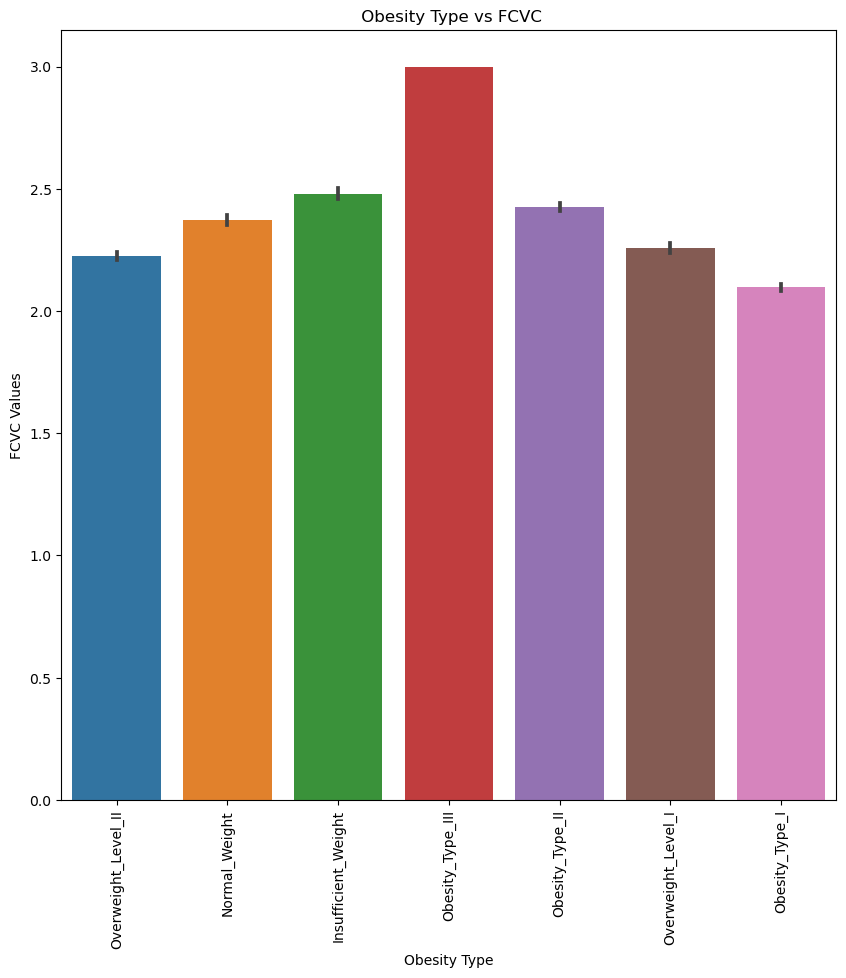

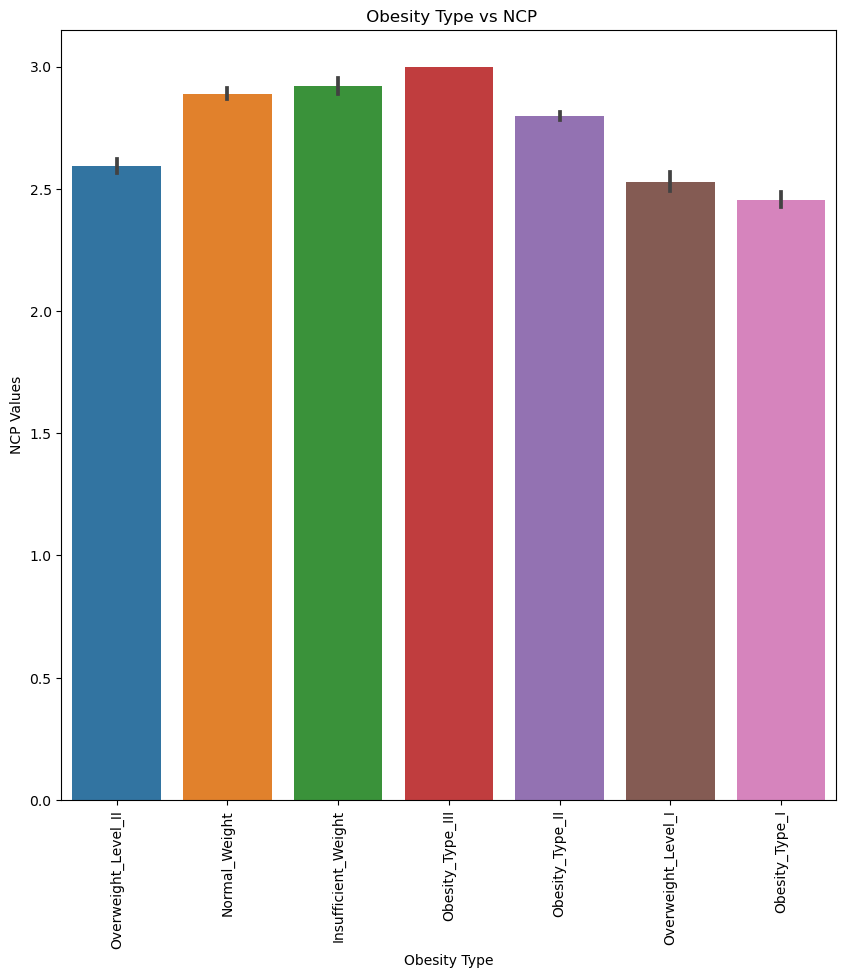

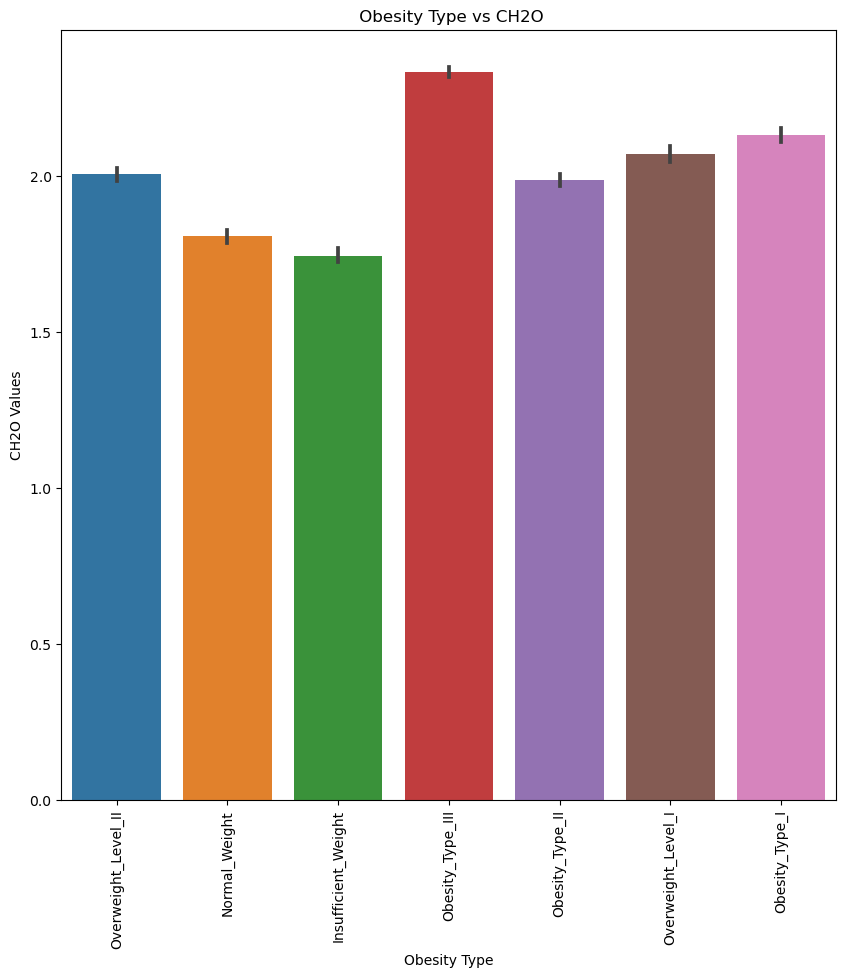

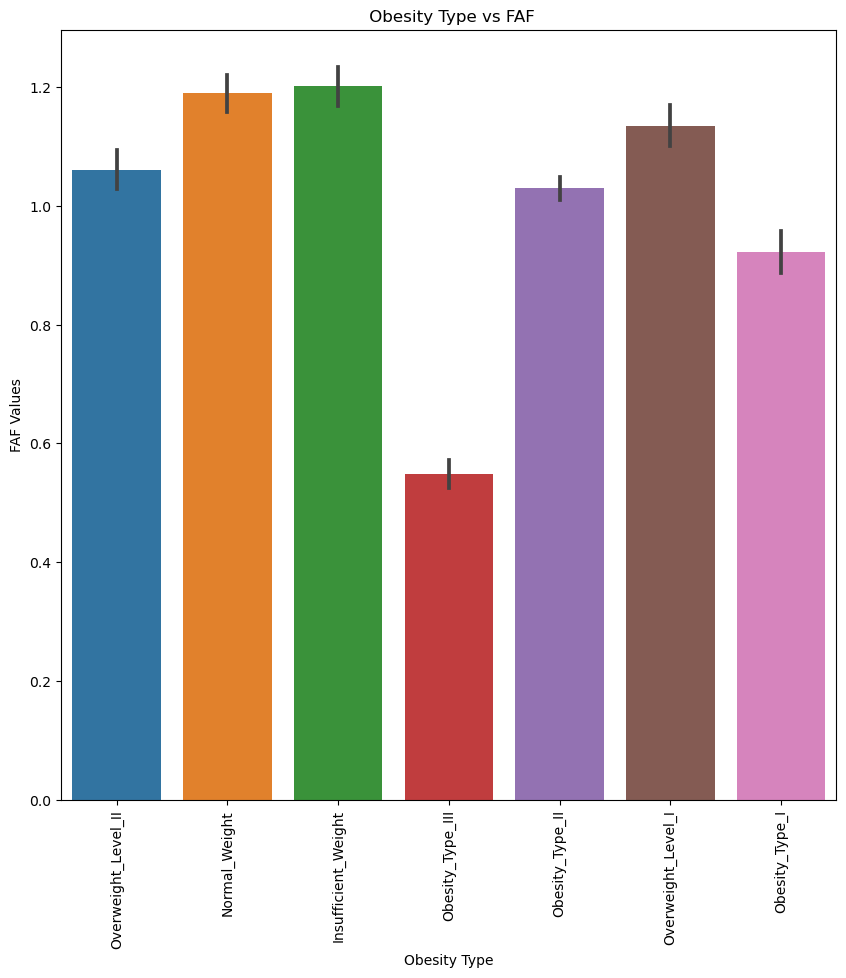

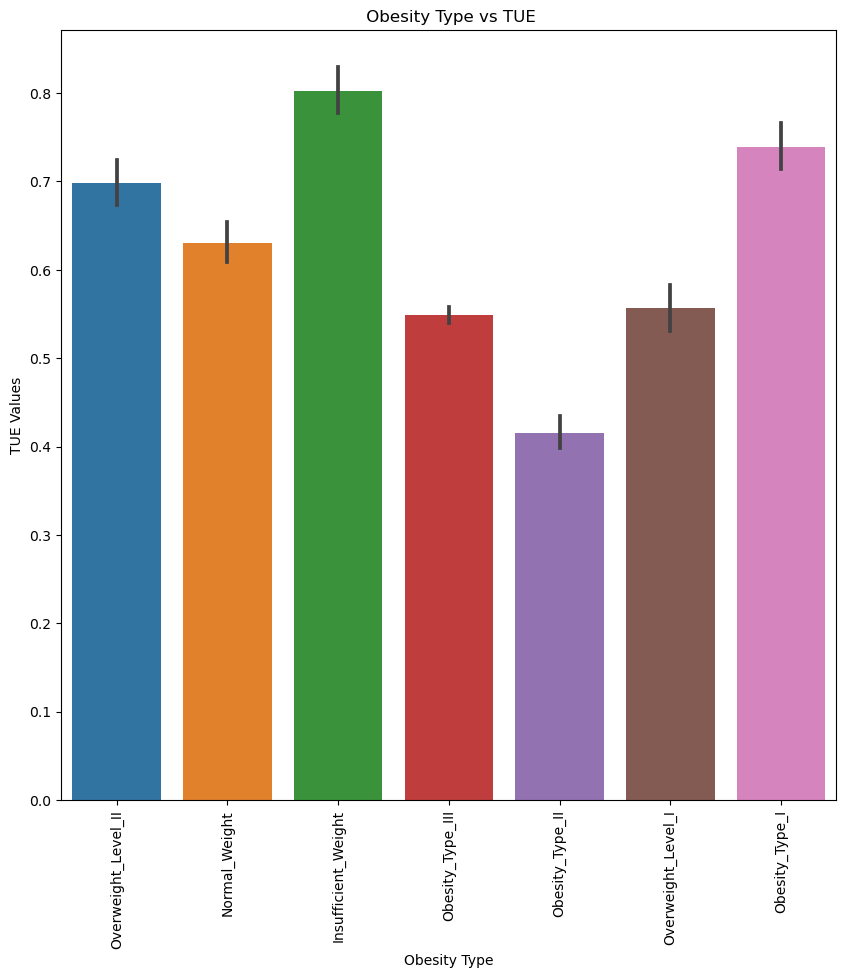

In [ ]:
for i in col:
    plt.figure(figsize=(10,10))
    sns.barplot(x='NObeyesdad', y=i, data=df_train)
    plt.xticks(rotation=90)
    plt.xlabel('Obesity Type')
    plt.ylabel(f'{i} Values')
    plt.title(f' Obesity Type vs {i}')
    
plt.show()

/var/folders/ld/78fcn_f90sd0mc0hvm8w8wmh0000gn/T/ipykernel_7015/2242761515.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



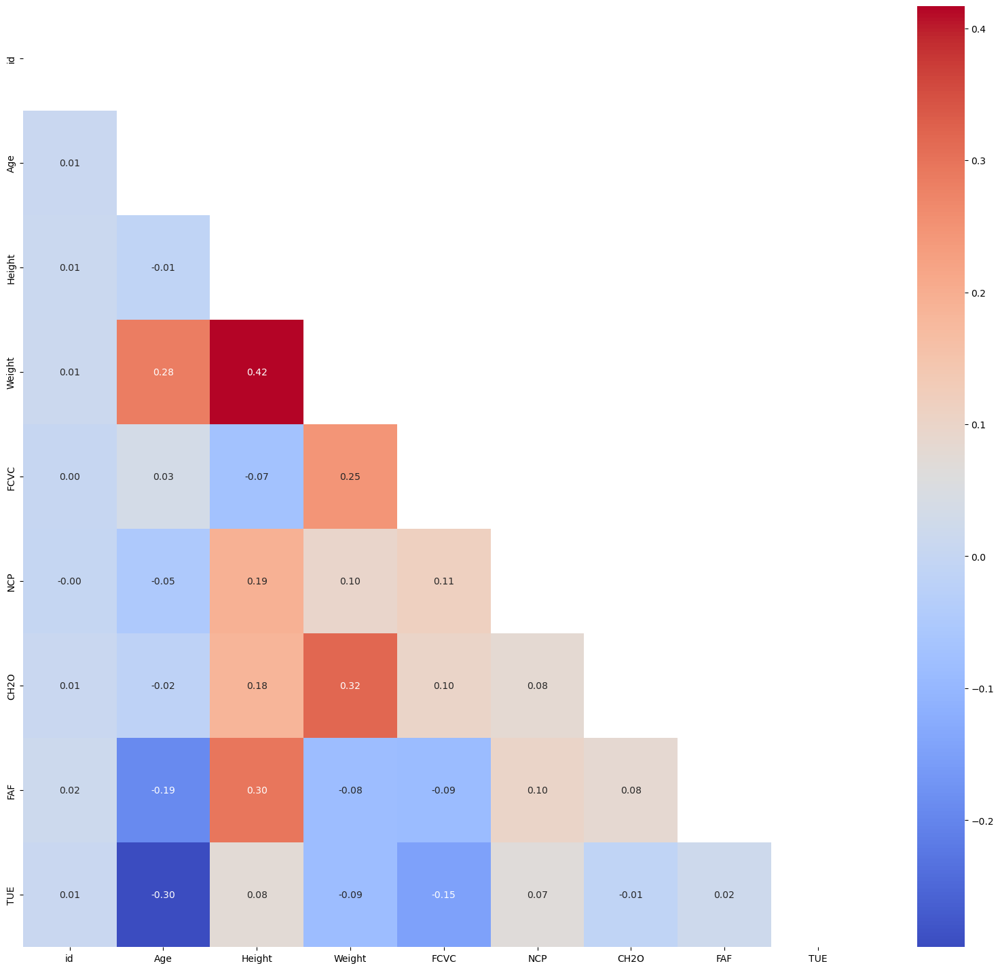

In [ ]:
# Correlation matrix
correlation_matrix = df_train.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# figure
plt.figure(figsize=(20, 18))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(correlation_matrix, mask=mask, annot=True, cmap='coolwarm', fmt=".2f")

plt.show()

- There is a correlation between height and wight, and between CH2O and weight

----------------

# `04` Data Preparation

Perform data cleaning, feature engineering, scaling, dropping unwanted columns

In [13]:
df_train_new = train.copy()

## `04.1` Feature Engineering

### Body Mass Index

- Body mass index (BMI) is a measure of body fat based on height and weight that applies to adult men and women.
- Calculate BMI using the formula: BMI = Weight (kg) / (Height (m) * Height (m))

- according to : https://www.cdc.gov/obesity/basics/adult-defining.html

    - If your BMI is less than 18.5, it falls within the underweight range.
    - If your BMI is 18.5 to <25, it falls within the healthy weight range.
    - If your BMI is 25.0 to <30, it falls within the overweight range.
    - If your BMI is 30.0 or higher, it falls within the obesity range.

- Obesity is frequently subdivided into categories:

    - Class 1: BMI of 30 to < 35
    - Class 2: BMI of 35 to < 40
    - Class 3: BMI of 40 or higher. Class 3 obesity is sometimes categorized as “severe” obesity.

In [14]:
def BMI_cat(row):
    bmi = row['Weight'] / (row['Height'] ** 2)  
   
    if bmi < 18.5:
        return "Underweight"
    elif 18.5 <= bmi < 25:
        return "Healthy weight"
    elif 25 <= bmi < 30:
        return "Overweight"
    elif 30 <= bmi < 35:
        return "Obesity (Class 1)"
    elif 35 <= bmi < 40:
        return "Obesity (Class 2)"
    else:
        return "Obesity (Class 3)"

df_train_new['BMI_cat'] = df_train_new.apply(BMI_cat, axis=1)

In [15]:
# Count the occurrences of each BMI category
bmi_category_counts = df_train_new['BMI_cat'].value_counts()

# Create a bar plot
fig = px.bar(bmi_category_counts, x=bmi_category_counts.index, y=bmi_category_counts.values)

# Update layout
fig.update_layout(
    title='Distribution of BMI Categories',
    xaxis_title='BMI Category',
    yaxis_title='Count',
    showlegend=False
)

# Show plot
fig.show()

### Meal Habits

- Combination of 'FCVC' (Frequency of consumption of vegetables) and 'NCP' (Number of main meals) created the 'Meal_Habits' feature.
- This feature seeks to encapsulate overall dietary patterns, considering both the frequency of vegetable consumption and the number of main meals.

In [16]:
df_train_new['Meal_Habits'] = df_train_new['FCVC'] * df_train_new['NCP']
df_train_new['Veg_Meal_Ratio'] = df_train_new['FCVC'] / df_train_new['NCP']

In [27]:
# Create 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=df_train_new['FCVC'],
    y=df_train_new['NCP'],
    z=df_train_new['Veg_Meal_Ratio'],
    mode='markers',
    marker=dict(
        size=5,
        color=df_train_new['Veg_Meal_Ratio'],  # Color by Veg_Meal_Ratio
        colorscale='Viridis',  # Set colorscale
        opacity=0.8
    )
)])

# Update layout
fig.update_layout(
    scene=dict(
        xaxis_title='FCVC',
        yaxis_title='NCP',
        zaxis_title='Veg_Meal_Ratio'
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)

# Show plot
fig.show()

In [28]:
# Create 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=df_train_new['FCVC'],
    y=df_train_new['NCP'],
    z=df_train_new['Meal_Habits'],
    mode='markers',
    marker=dict(
        size=5,
        color=df_train_new['Meal_Habits'],  # Color by Meal_Habits
        colorscale='Viridis',  # Set colorscale
        opacity=0.8
    )
)])

# Update layout
fig.update_layout(
    scene=dict(
        xaxis_title='FCVC',
        yaxis_title='NCP',
        zaxis_title='Meal_Habits'
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)

# Show plot
fig.show()

### Tech Usage Score

- A comprehensive score was crafted by weighting the frequency of technology usage ('TUE') by the individual's age.
- The resulting 'Tech_Usage_Score' aims to quantify the average time spent using technology relative to the person's age, providing a nuanced perspective on technology habits.

In [17]:
df_train_new['Tech_Usage_Score'] = df_train_new['TUE'] / df_train_new['Age']

In [30]:
# Create 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=df_train_new['Age'],
    y=df_train_new['TUE'],
    z=df_train_new['Tech_Usage_Score'],
    mode='markers',
    marker=dict(
        size=5,
        color=df_train_new['Tech_Usage_Score'],  # Color by Tech_Usage_Score
        colorscale='Viridis',  # Set colorscale
        opacity=0.8
    )
)])

# Update layout
fig.update_layout(
    scene=dict(
        xaxis_title='Age',
        yaxis_title='TUE',
        zaxis_title='Tech Usage Score'
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)

# Show plot
fig.show()

### Activity

- if the person use bike or walk, his activity will be high.
- if the person use transportation,car, motorbike, activity will be low.

In [18]:
def map_physical_activity(mode):
    if mode in ['Public_Transportation', 'Automobile', 'Motorbike']:
        return 'low'
    else:
        return 'High'

# Create the new column 'physical_activity' using the mapping function
df_train_new['Activity'] = df_train_new['MTRANS'].apply(map_physical_activity)

In [32]:
# Count the occurrences of each category
activity_counts = df_train_new['Activity'].value_counts()

# Create a bar plot
fig = px.bar(activity_counts, x=activity_counts.index, y=activity_counts.values)

# Update layout
fig.update_layout(
    title='Distribution of Activity',
    xaxis_title='Activity Level',
    yaxis_title='Count',
    showlegend=False
)

# Show plot
fig.show()

### Age Classification

In [19]:
bins = [14, 18, 25, 35, 45, 61]
labels = ['Teenagers', 'Young Adults', 'Adults', 'Middle-aged', 'Senior Adults']

# Bin the age column
df_train_new['age_categories'] = pd.cut(df_train_new['Age'], bins=bins, labels=labels,right=False)
df_train_new['age_categories'] = df_train_new['age_categories'].astype(str)

In [34]:
# Count the occurrences of each age category
age_category_counts = df_train_new['age_categories'].value_counts()

# Create a bar plot
fig = px.bar(age_category_counts, x=age_category_counts.index, y=age_category_counts.values)

# Update layout
fig.update_layout(
    title='Distribution of Age Categories',
    xaxis_title='Age Category',
    yaxis_title='Count',
    showlegend=False
)

# Show plot
fig.show()

## `04.2` Rounding

In [20]:
columns_to_round = ['NCP','FCVC', 'CH2O', 'TUE', 'FAF']
df_train_new[columns_to_round] = df_train_new[columns_to_round].round()

## `04.3` Encoding and Scaling

In [21]:
df_train_new.head()

,id,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,...,TUE,CALC,MTRANS,NObeyesdad,BMI_cat,Meal_Habits,Veg_Meal_Ratio,Tech_Usage_Score,Activity,age_categories
0,0,Male,24.443011,1.699998,81.669950,yes,yes,2.0,3.0,Sometimes,...,1.0,Sometimes,Public_Transportation,Overweight_Level_II,Overweight,5.966594,0.670399,0.039949,low,Young Adults
1,1,Female,18.000000,1.560000,57.000000,yes,yes,2.0,3.0,Frequently,...,1.0,no,Automobile,Normal_Weight,Healthy weight,6.000000,0.666667,0.055556,low,Young Adults
2,2,Female,18.000000,1.711460,50.165754,yes,yes,2.0,1.0,Sometimes,...,2.0,no,Public_Transportation,Insufficient_Weight,Underweight,2.654722,1.332120,0.092977,low,Young Adults
3,3,Female,20.952737,1.710730,131.274851,yes,yes,3.0,3.0,Sometimes,...,1.0,Sometimes,Public_Transportation,Obesity_Type_III,Obesity (Class 3),9.000000,1.000000,0.037236,low,Young Adults
4,4,Male,31.641081,1.914186,93.798055,yes,yes,3.0,2.0,Sometimes,...,1.0,Sometimes,Public_Transportation,Overweight_Level_II,Overweight,5.282883,1.359220,0.029447,low,Adults


In [37]:
df_train_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20758 entries, 0 to 20757
Data columns (total 24 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              20758 non-null  int64  
 1   Gender                          20758 non-null  object 
 2   Age                             20758 non-null  float64
 3   Height                          20758 non-null  float64
 4   Weight                          20758 non-null  float64
 5   family_history_with_overweight  20758 non-null  object 
 6   FAVC                            20758 non-null  object 
 7   FCVC                            20758 non-null  float64
 8   NCP                             20758 non-null  float64
 9   CAEC                            20758 non-null  object 
 10  SMOKE                           20758 non-null  object 
 11  CH2O                            20758 non-null  float64
 12  SCC                             

In [22]:
label = LabelEncoder()

In [39]:
df_train_new.head(3)

,id,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,...,TUE,CALC,MTRANS,NObeyesdad,BMI_cat,Meal_Habits,Veg_Meal_Ratio,Tech_Usage_Score,Activity,age_categories
0,0,Male,24.443011,1.699998,81.669950,yes,yes,2.0,3.0,Sometimes,...,1.0,Sometimes,Public_Transportation,Overweight_Level_II,Overweight,5.966594,0.670399,0.039949,low,Young Adults
1,1,Female,18.000000,1.560000,57.000000,yes,yes,2.0,3.0,Frequently,...,1.0,no,Automobile,Normal_Weight,Healthy weight,6.000000,0.666667,0.055556,low,Young Adults
2,2,Female,18.000000,1.711460,50.165754,yes,yes,2.0,1.0,Sometimes,...,2.0,no,Public_Transportation,Insufficient_Weight,Underweight,2.654722,1.332120,0.092977,low,Young Adults


In [23]:
df_y= df_train_new['NObeyesdad']
df_without_tar = df_train_new.drop(columns=['NObeyesdad','id'], axis=1)
cat_columns = df_without_tar.select_dtypes(include="object").columns.tolist()
cat_columns

['Gender',
 'family_history_with_overweight',
 'FAVC',
 'CAEC',
 'SMOKE',
 'SCC',
 'CALC',
 'MTRANS',
 'BMI_cat',
 'Activity',
 'age_categories']

In [24]:
df_without_tar.head(3)

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,...,FAF,TUE,CALC,MTRANS,BMI_cat,Meal_Habits,Veg_Meal_Ratio,Tech_Usage_Score,Activity,age_categories
0,Male,24.443011,1.699998,81.669950,yes,yes,2.0,3.0,Sometimes,no,...,0.0,1.0,Sometimes,Public_Transportation,Overweight,5.966594,0.670399,0.039949,low,Young Adults
1,Female,18.000000,1.560000,57.000000,yes,yes,2.0,3.0,Frequently,no,...,1.0,1.0,no,Automobile,Healthy weight,6.000000,0.666667,0.055556,low,Young Adults
2,Female,18.000000,1.711460,50.165754,yes,yes,2.0,1.0,Sometimes,no,...,1.0,2.0,no,Public_Transportation,Underweight,2.654722,1.332120,0.092977,low,Young Adults


In [25]:
num_columns = df_without_tar.select_dtypes(include="number").columns.tolist()
num_columns

['Age',
 'Height',
 'Weight',
 'FCVC',
 'NCP',
 'CH2O',
 'FAF',
 'TUE',
 'Meal_Habits',
 'Veg_Meal_Ratio',
 'Tech_Usage_Score']

In [26]:
cat_pipeline = make_pipeline(SimpleImputer(strategy="most_frequent"),
                            OneHotEncoder(handle_unknown="ignore"))

default_num_pipeline = make_pipeline(SimpleImputer(strategy="median"),
                                    StandardScaler())

preprocessing = ColumnTransformer([
                                  ("num",default_num_pipeline,num_columns),
                                  ("cat",cat_pipeline,cat_columns),])

In [27]:
train_copy_prepared = preprocessing.fit_transform(df_without_tar)
preprocessing.get_feature_names_out()

array(['num__Age', 'num__Height', 'num__Weight', 'num__FCVC', 'num__NCP',
       'num__CH2O', 'num__FAF', 'num__TUE', 'num__Meal_Habits',
       'num__Veg_Meal_Ratio', 'num__Tech_Usage_Score',
       'cat__Gender_Female', 'cat__Gender_Male',
       'cat__family_history_with_overweight_no',
       'cat__family_history_with_overweight_yes', 'cat__FAVC_no',
       'cat__FAVC_yes', 'cat__CAEC_Always', 'cat__CAEC_Frequently',
       'cat__CAEC_Sometimes', 'cat__CAEC_no', 'cat__SMOKE_no',
       'cat__SMOKE_yes', 'cat__SCC_no', 'cat__SCC_yes',
       'cat__CALC_Frequently', 'cat__CALC_Sometimes', 'cat__CALC_no',
       'cat__MTRANS_Automobile', 'cat__MTRANS_Bike',
       'cat__MTRANS_Motorbike', 'cat__MTRANS_Public_Transportation',
       'cat__MTRANS_Walking', 'cat__BMI_cat_Healthy weight',
       'cat__BMI_cat_Obesity (Class 1)', 'cat__BMI_cat_Obesity (Class 2)',
       'cat__BMI_cat_Obesity (Class 3)', 'cat__BMI_cat_Overweight',
       'cat__BMI_cat_Underweight', 'cat__Activity_High',
   

In [28]:
train_copy_prepared

array([[ 0.10569857, -0.00282826, -0.23571264, ...,  0.        ,
         1.        ,  0.        ],
       [-1.0270519 , -1.60629083, -1.17093118, ...,  0.        ,
         1.        ,  0.        ],
       [-1.0270519 ,  0.12845138, -1.43001211, ...,  0.        ,
         1.        ,  0.        ],
       ...,
       [-0.65766899,  1.36653688,  0.6707173 , ...,  0.        ,
         1.        ,  0.        ],
       [ 1.76006735, -0.00280536, -0.16557441, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.49905134,  1.33206194,  1.14664506, ...,  0.        ,
         0.        ,  0.        ]])

In [29]:
df_y = label.fit_transform(df_y)

In [30]:
train_copy_prepared.shape

(20758, 47)

----------------

# `05` Model

#### Model on orign Data

In [31]:
orgin = train.copy() 
orgin_train=orgin.drop(columns=['id','NObeyesdad'],axis=1)
orgin_lable=orgin['NObeyesdad']
cat = orgin_train.select_dtypes(include='object')
num = orgin_train.select_dtypes(exclude='object')
num.head(2)
cat.head(2)

,Gender,family_history_with_overweight,FAVC,CAEC,SMOKE,SCC,CALC,MTRANS
0,Male,yes,yes,Sometimes,no,no,Sometimes,Public_Transportation
1,Female,yes,yes,Frequently,no,no,no,Automobile


In [32]:
la=LabelEncoder()
one_hott= OneHotEncoder()
scaler =StandardScaler()
orgin_lable=la.fit_transform(orgin_lable)
cat_encoding=one_hott.fit_transform(cat).toarray()
encoded_data=pd.DataFrame(cat_encoding,columns=one_hott.get_feature_names_out())
encoded_data.head(2)

,Gender_Female,Gender_Male,family_history_with_overweight_no,family_history_with_overweight_yes,FAVC_no,FAVC_yes,CAEC_Always,CAEC_Frequently,CAEC_Sometimes,CAEC_no,...,SCC_no,SCC_yes,CALC_Frequently,CALC_Sometimes,CALC_no,MTRANS_Automobile,MTRANS_Bike,MTRANS_Motorbike,MTRANS_Public_Transportation,MTRANS_Walking
0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0


In [33]:
num_scaler = pd.DataFrame(scaler.fit_transform(num),columns=num.columns)
final_data = pd.concat([encoded_data, num_scaler], axis=1)
final_data.head(2)

,Gender_Female,Gender_Male,family_history_with_overweight_no,family_history_with_overweight_yes,FAVC_no,FAVC_yes,CAEC_Always,CAEC_Frequently,CAEC_Sometimes,CAEC_no,...,MTRANS_Public_Transportation,MTRANS_Walking,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE
0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.105699,-0.002828,-0.235713,-0.836279,0.314684,1.206594,-1.171141,0.597438
1,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,-1.027052,-1.606291,-1.170931,-0.836279,0.338364,-0.048349,0.021775,0.636513


In [41]:
model_d = DecisionTreeClassifier(random_state=1234, class_weight='balanced')
y_train_predict = cross_val_predict(model_d ,final_data, orgin_lable, cv=3)
print("precision_score :",precision_score(orgin_lable ,y_train_predict ,average='micro'))
print("f1_score :",f1_score(orgin_lable,y_train_predict,average='micro'))
print(accuracy_score(orgin_lable, y_train_predict))

precision_score : 0.8417477598997977
f1_score : 0.8417477598997977
0.8417477598997977


## `05.1` Decision Tree Classifier

In [52]:
model = DecisionTreeClassifier(random_state=1234, class_weight='balanced')

In [53]:
model.fit(train_copy_prepared, df_y)

DecisionTreeClassifier(class_weight='balanced', random_state=1234)

In [54]:
y_train_predict = cross_val_predict(model, train_copy_prepared, df_y, cv=3)

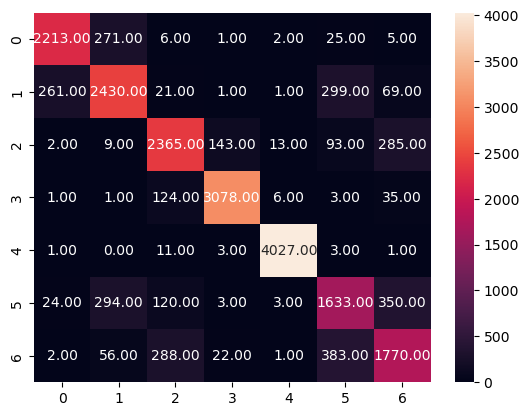

In [55]:
cm = confusion_matrix(df_y, y_train_predict)
sns.heatmap(cm, annot=True,fmt=".2f")
plt.show()

In [56]:
accuracy_score(df_y, y_train_predict)

0.8438192504094807

In [57]:
f1_score(df_y, y_train_predict, average='micro')

0.8438192504094807

In [58]:
feature_names = preprocessing.get_feature_names_out()

In [59]:
feature_importance = model.feature_importances_
sorted_indices = feature_importance.argsort()[::-1]
sorted_feature_names = feature_names[sorted_indices]
sorted_importances = feature_importance[sorted_indices]
sorted_importances

array([2.73491503e-01, 1.53881397e-01, 1.26893139e-01, 1.02913639e-01,
       7.25608074e-02, 5.64223711e-02, 5.41494970e-02, 2.11309135e-02,
       2.10828551e-02, 1.45894131e-02, 1.28933799e-02, 1.25645857e-02,
       8.22266301e-03, 7.42385929e-03, 5.37884658e-03, 4.39504564e-03,
       4.19390107e-03, 4.17736931e-03, 3.58162229e-03, 3.55032026e-03,
       3.29330038e-03, 3.07850293e-03, 2.85063657e-03, 2.85045833e-03,
       2.76571769e-03, 2.54760920e-03, 2.34941711e-03, 2.28341276e-03,
       2.17533728e-03, 2.13836532e-03, 1.85607591e-03, 1.63186643e-03,
       1.57548346e-03, 1.35298649e-03, 9.52302411e-04, 4.84975724e-04,
       4.82898130e-04, 3.76119241e-04, 3.19929698e-04, 2.35956273e-04,
       2.27500793e-04, 2.06076823e-04, 1.87983029e-04, 1.52133768e-04,
       1.24660796e-04, 3.16523244e-06, 0.00000000e+00])

In [60]:
top_10_importances = sorted_importances[:10]          # select the most 20 important features
top_10_feature_names = sorted_feature_names[:10]

<AxesSubplot: >

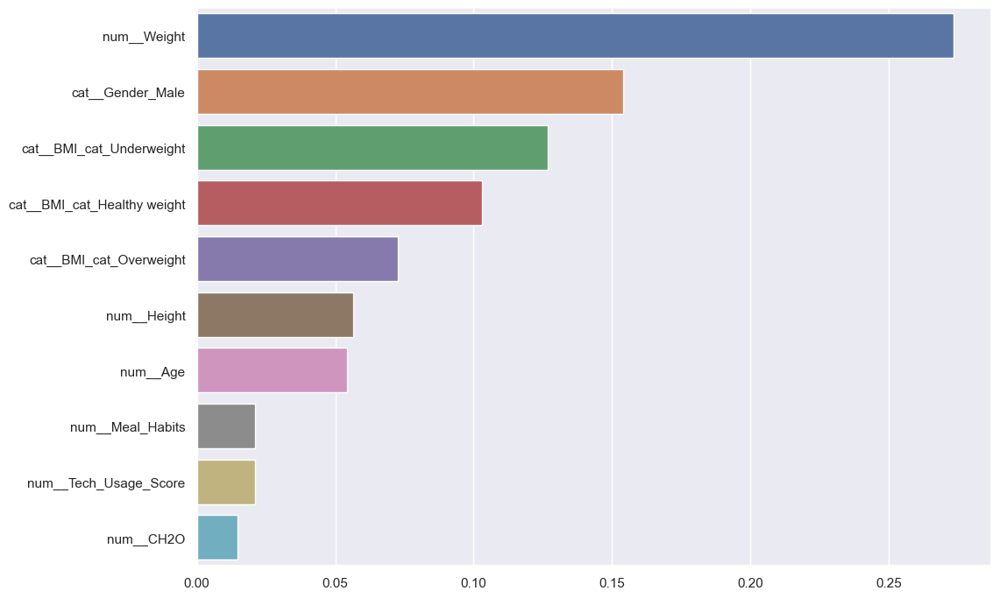

In [61]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(x = top_10_importances,y = top_10_feature_names)

## `05.2` Random Forest Classifier

In [50]:
rf = RandomForestClassifier(random_state=42, n_estimators=100, max_depth=20, min_samples_split=2, min_samples_leaf=1,
                            criterion='gini', bootstrap=True,
                            class_weight=None, ccp_alpha=0.0, max_samples=None)

In [51]:
rf.fit(train_copy_prepared, df_y)

RandomForestClassifier(max_depth=20, random_state=42)

In [63]:
y_train_predict_rf = cross_val_predict(rf,train_copy_prepared, df_y, cv=3)

In [64]:
print('Accuracy:', accuracy_score(df_y, y_train_predict_rf))
print('Classification Report:\n', classification_report(df_y, y_train_predict_rf))
print('Confusion Matrix:\n', confusion_matrix(df_y, y_train_predict_rf))

Accuracy: 0.8890548222372098
Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.91      0.92      2523
           1       0.83      0.89      0.86      3082
           2       0.88      0.87      0.87      2910
           3       0.96      0.97      0.96      3248
           4       1.00      1.00      1.00      4046
           5       0.80      0.70      0.75      2427
           6       0.77      0.80      0.78      2522

    accuracy                           0.89     20758
   macro avg       0.88      0.88      0.88     20758
weighted avg       0.89      0.89      0.89     20758

Confusion Matrix:
 [[2298  211    0    1    0   10    3]
 [ 172 2732    6    0    0  140   32]
 [   3    5 2536  106   11   58  191]
 [   0    1   79 3141    1    2   24]
 [   1    0    5    3 4034    3    0]
 [  15  295   52    0    0 1702  363]
 [   1   49  216   22    0  222 2012]]


In [65]:
feature_importance = rf.feature_importances_
sorted_indices = feature_importance.argsort()[::-1]
sorted_feature_names = feature_names[sorted_indices]
sorted_importances = feature_importance[sorted_indices]
sorted_importances

array([1.88620364e-01, 7.13538677e-02, 6.80885287e-02, 6.19170723e-02,
       5.63036111e-02, 5.37143016e-02, 5.27895725e-02, 5.07560622e-02,
       4.83323575e-02, 4.24740674e-02, 3.35163038e-02, 3.26631856e-02,
       2.83782197e-02, 2.70938721e-02, 1.73825978e-02, 1.49227421e-02,
       1.40357756e-02, 1.37805895e-02, 1.10918181e-02, 1.07280980e-02,
       1.07112425e-02, 1.00311806e-02, 8.46682232e-03, 7.85350762e-03,
       7.68211777e-03, 6.73220112e-03, 6.21661311e-03, 5.74833684e-03,
       5.65738046e-03, 5.57486686e-03, 5.10752061e-03, 2.92271546e-03,
       2.56755184e-03, 2.56508953e-03, 2.40303887e-03, 2.30249284e-03,
       2.12750349e-03, 1.92435556e-03, 1.20047644e-03, 1.14419481e-03,
       1.13133518e-03, 5.99406363e-04, 5.68769977e-04, 4.70595937e-04,
       1.71529780e-04, 1.52240445e-04, 2.39060020e-05])

In [66]:
top_10_importances = sorted_importances[:10]          # select the most 20 important features
top_10_feature_names = sorted_feature_names[:10]

<AxesSubplot: >

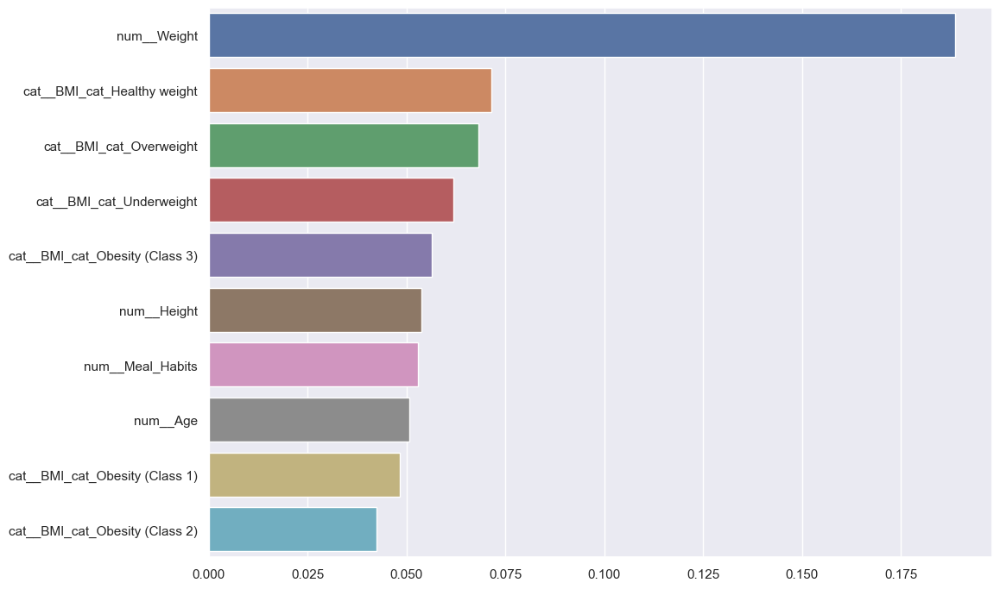

In [67]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(x = top_10_importances,y = top_10_feature_names)

## Logistic Regression

In [68]:
baseline_model=LogisticRegression(penalty=None,random_state=1234,class_weight='balanced')

In [69]:
y_train_predict = cross_val_predict(baseline_model,train_copy_prepared, df_y, cv=3)

print("accuracy_score : ",accuracy_score(df_y, y_train_predict) )              
 
print("precision_score : ",precision_score(df_y, y_train_predict,average ='micro'))
 
print("f1_score : ",f1_score(df_y, y_train_predict,average ='micro'))

accuracy_score :  0.8739281240967338
precision_score :  0.8739281240967338
f1_score :  0.8739281240967339


### Regularization

In [70]:
reg_model=LogisticRegression(penalty='l2',C=1.0,random_state=1234,class_weight='balanced')
 
 
reg_model.fit(train_copy_prepared,df_y)
 
y_train_predict = cross_val_predict(baseline_model,train_copy_prepared, df_y, cv=3)


print("accuracy_score : ",accuracy_score(df_y, y_train_predict) )              
 
print("precision_score : ",precision_score(df_y, y_train_predict,average ='micro'))
 
print("f1_score : ",f1_score(df_y, y_train_predict,average ='micro'))

accuracy_score :  0.8739281240967338
precision_score :  0.8739281240967338
f1_score :  0.8739281240967339


## KNN

In [71]:
knn_model = KNeighborsClassifier(n_neighbors=15, weights="distance")

In [72]:
y_train_predict = cross_val_predict(knn_model,train_copy_prepared, df_y, cv=3)
print("accuracy_score : ",accuracy_score(df_y, y_train_predict) ) 
print("f1_score : ",f1_score(df_y, y_train_predict,average ='micro'))             
print('Classification Report:\n', classification_report(df_y, y_train_predict))


accuracy_score :  0.8350515463917526
f1_score :  0.8350515463917526
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.89      0.89      2523
           1       0.80      0.83      0.81      3082
           2       0.81      0.81      0.81      2910
           3       0.91      0.95      0.93      3248
           4       0.99      1.00      0.99      4046
           5       0.66      0.53      0.59      2427
           6       0.67      0.70      0.68      2522

    accuracy                           0.84     20758
   macro avg       0.82      0.82      0.81     20758
weighted avg       0.83      0.84      0.83     20758



## `05.2` SVM_POLY

In [73]:
model2 = SVC(kernel='poly', random_state=1234)

In [74]:
y_train_predict = cross_val_predict(model2,train_copy_prepared, df_y,cv=3)

In [75]:
accuracy_score(y_train_predict, df_y)

0.8746507370652279

<AxesSubplot: >

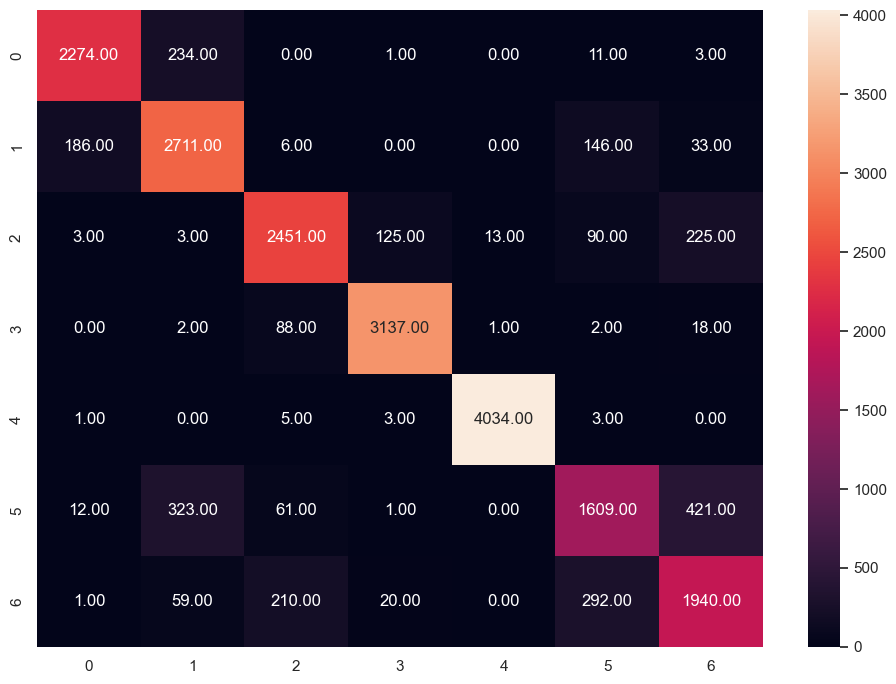

In [76]:
cm = confusion_matrix(df_y,y_train_predict)
sns.heatmap(cm, annot=True,fmt=".2f")

In [77]:
print(classification_report(y_train_predict, df_y))

              precision    recall  f1-score   support

           0       0.90      0.92      0.91      2477
           1       0.88      0.81      0.85      3332
           2       0.84      0.87      0.86      2821
           3       0.97      0.95      0.96      3287
           4       1.00      1.00      1.00      4048
           5       0.66      0.75      0.70      2153
           6       0.77      0.73      0.75      2640

    accuracy                           0.87     20758
   macro avg       0.86      0.86      0.86     20758
weighted avg       0.88      0.87      0.88     20758



##  AdaBoost

In [78]:
adaboost_classifier = AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=10),
                                         n_estimators=70,
                                         learning_rate=0.01,
                                         random_state=42)


In [79]:
y_train_predict = cross_val_predict(adaboost_classifier,train_copy_prepared, df_y, cv=3)
print("accuracy_score : ",accuracy_score(df_y, y_train_predict) )   
print("f1_score : ",f1_score(df_y, y_train_predict,average ='micro'))             
print('Classification Report:\n', classification_report(df_y, y_train_predict))


accuracy_score :  0.8769630985644089
f1_score :  0.8769630985644088
Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.91      0.91      2523
           1       0.84      0.84      0.84      3082
           2       0.86      0.84      0.85      2910
           3       0.96      0.96      0.96      3248
           4       1.00      1.00      1.00      4046
           5       0.74      0.73      0.74      2427
           6       0.76      0.76      0.76      2522

    accuracy                           0.88     20758
   macro avg       0.86      0.86      0.86     20758
weighted avg       0.88      0.88      0.88     20758



## XGBClassifier

In [80]:
xgb_model = XGBClassifier()
 
# Predicting

y_train_predict = cross_val_predict(xgb_model,train_copy_prepared, df_y, cv=3)

 


In [81]:
# Evaluate the model

accuracy = accuracy_score(df_y, y_train_predict)

print(f"Accuracy: {accuracy}")
 
print("precision_score : ",precision_score(df_y, y_train_predict,average ='micro'))
 
print("f1_score : ",f1_score(df_y, y_train_predict,average ='micro'))
 


Accuracy: 0.9014355910974082
precision_score :  0.9014355910974082
f1_score :  0.9014355910974082


### Tuning

In [82]:
X_train, X_val, y_train, y_val = train_test_split(train_copy_prepared, df_y, test_size=0.2, random_state=42)

In [ ]:
# Define the objective function for Optuna optimization
def objective(trial, X_train, y_train, X_val, y_val):
    # Define parameters to be optimized for the XGBClassifier
    param = {
        "objective": "multi:softmax",
        "num_class": 7,
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.05),
        "n_estimators": trial.suggest_int("n_estimators", 400, 600),
        "max_depth": trial.suggest_int("max_depth", 6, 14),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.3, 0.9),
        "subsample": trial.suggest_float("subsample", 0.8, 1.0),
        "min_child_weight": trial.suggest_int("min_child_weight", 10, 50),
    }

    # Create an instance of XGBClassifier with the suggested parameters
    xgb_classifier = XGBClassifier(**param)

    # Fit the classifier on the training data
    xgb_classifier.fit(X_train, y_train)

    # Evaluate the classifier on the validation data
    score = xgb_classifier.score(X_val, y_val)

    return score


# Set up the sampler for Optuna optimization
sampler = optuna.samplers.TPESampler(seed=42)  # Using Tree-structured Parzen Estimator sampler for optimization

# Create a study object for Optuna optimization
study = optuna.create_study(direction="maximize", sampler=sampler)

# Run the optimization process
study.optimize(lambda trial: objective(trial, X_train, y_train, X_val, y_val), n_trials=100)

# Get the best parameters after optimization
best_params = study.best_params

print('='*50)
print(best_params)

In [84]:

params = {'learning_rate': 0.02328877788069453,
           'n_estimators': 509,
           'max_depth': 11, 
           'colsample_bytree': 0.5325753386105174, 
           'subsample': 0.9342903229566071, 
           'min_child_weight': 30,
            'random_state':42}

XGB_Classifier = XGBClassifier(**params)

y_train_predict = cross_val_predict(XGB_Classifier,train_copy_prepared,  df_y,cv=3)

# Fit the classifier on the training dat
# Evaluate accuracy on the training set
accuracy_train = accuracy_score(df_y, y_train_predict)
print("Accuracy on training set:", accuracy_train)

# Classification report on the training set
print("Classification report on training set:")
print(classification_report(df_y, y_train_predict))

Accuracy on training set: 0.9033143848154929
Classification report on training set:
              precision    recall  f1-score   support

           0       0.92      0.93      0.93      2523
           1       0.86      0.88      0.87      3082
           2       0.89      0.88      0.89      2910
           3       0.97      0.97      0.97      3248
           4       1.00      1.00      1.00      4046
           5       0.81      0.77      0.78      2427
           6       0.81      0.82      0.81      2522

    accuracy                           0.90     20758
   macro avg       0.89      0.89      0.89     20758
weighted avg       0.90      0.90      0.90     20758



## `05.3` CatBoost

In [92]:
model3 = CatBoostClassifier(iterations=1000,
                           learning_rate=0.1,
                           random_state = 1234,
                           loss_function='MultiClass')

In [93]:
y_train_predict = cross_val_predict(model3,train_copy_prepared,  df_y,cv=3)

0:	learn: 1.5962665	total: 208ms	remaining: 3m 28s
1:	learn: 1.3785606	total: 252ms	remaining: 2m 5s
2:	learn: 1.2197529	total: 288ms	remaining: 1m 35s
3:	learn: 1.1056196	total: 323ms	remaining: 1m 20s
4:	learn: 1.0094970	total: 358ms	remaining: 1m 11s
5:	learn: 0.9312623	total: 391ms	remaining: 1m 4s
6:	learn: 0.8678447	total: 429ms	remaining: 1m
7:	learn: 0.8137289	total: 484ms	remaining: 1m
8:	learn: 0.7672149	total: 559ms	remaining: 1m 1s
9:	learn: 0.7277621	total: 587ms	remaining: 58.1s
10:	learn: 0.6932502	total: 622ms	remaining: 55.9s
11:	learn: 0.6618225	total: 648ms	remaining: 53.3s
12:	learn: 0.6329228	total: 678ms	remaining: 51.5s
13:	learn: 0.6093415	total: 737ms	remaining: 51.9s
14:	learn: 0.5875281	total: 766ms	remaining: 50.3s
15:	learn: 0.5676672	total: 809ms	remaining: 49.7s
16:	learn: 0.5499285	total: 860ms	remaining: 49.7s
17:	learn: 0.5338934	total: 894ms	remaining: 48.8s
18:	learn: 0.5184601	total: 916ms	remaining: 47.3s
19:	learn: 0.5061748	total: 949ms	remaining

In [94]:
accuracy_score(y_train_predict, df_y)

0.9021582040659023

<Axes: >

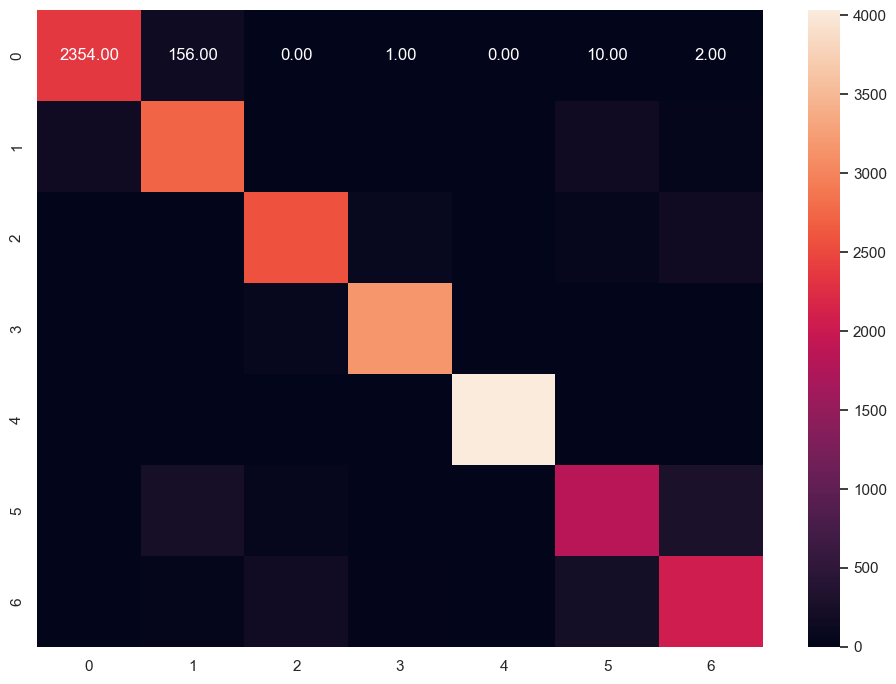

In [95]:
cm = confusion_matrix(df_y,y_train_predict)
sns.heatmap(cm, annot=True,fmt=".2f")

In [96]:
print(classification_report(y_train_predict, df_y))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93      2531
           1       0.88      0.86      0.87      3157
           2       0.89      0.89      0.89      2888
           3       0.97      0.96      0.97      3280
           4       1.00      1.00      1.00      4047
           5       0.75      0.80      0.77      2295
           6       0.81      0.80      0.81      2560

    accuracy                           0.90     20758
   macro avg       0.89      0.89      0.89     20758
weighted avg       0.90      0.90      0.90     20758



## `05.3` LGBM

In [97]:
lgb = LGBMClassifier(boosting_type="gbdt",
                     objective="multiclass",
                     metric="multi_logloss",
                     num_class=7,
                     learning_rate=0.025,
                     n_estimators=500,
                     lambda_l1=0.06,
                     lambda_l2=0.3,
                     max_depth=9,
                     colsample_bytree=0.40,
                     subsample=0.85,
                     min_child_samples=15,
                     verbosity=-1)

In [99]:
y_train_predict_rf = cross_val_predict(lgb,train_copy_prepared, df_y, cv=3)

In [100]:
accuracy_score(y_train_predict_rf, df_y)

0.9045187397629829

In [101]:
print(classification_report(y_train_predict_rf, df_y))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93      2535
           1       0.89      0.87      0.88      3147
           2       0.88      0.89      0.89      2876
           3       0.97      0.97      0.97      3266
           4       1.00      1.00      1.00      4046
           5       0.77      0.80      0.79      2319
           6       0.82      0.80      0.81      2569

    accuracy                           0.90     20758
   macro avg       0.89      0.89      0.89     20758
weighted avg       0.91      0.90      0.90     20758



In [102]:
# Define the objective function for Optuna optimization
def objective(trial, X_train, y_train, X_val, y_val):
    # Define parameters to be optimized for the LGBMClassifier
    param = {
        "objective": "multiclass",
        "metric": "multi_logloss",
        "verbosity": -1,
        "boosting_type": "gbdt",
        "random_state": 42,
        "num_class": 7,
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.05),
        "n_estimators": trial.suggest_int("n_estimators", 400, 600),
        "lambda_l1": trial.suggest_float("lambda_l1", 0.005, 0.015),
        "lambda_l2": trial.suggest_float("lambda_l2", 0.02, 0.06),
        "max_depth": trial.suggest_int("max_depth", 6, 14),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.3, 0.9),
        "subsample": trial.suggest_float("subsample", 0.8, 1.0),
        "min_child_samples": trial.suggest_int("min_child_samples", 10, 50),
    }

    # Create an instance of LGBMClassifier with the suggested parameters
    lgbm_classifier = LGBMClassifier(**param)
    
    # Fit the classifier on the training data
    lgbm_classifier.fit(X_train, y_train)

    # Evaluate the classifier on the test data
    score = lgbm_classifier.score(X_val, y_val)

    return score


# Set up the sampler for Optuna optimization
sampler = optuna.samplers.TPESampler(seed=42)  # Using Tree-structured Parzen Estimator sampler for optimization

# Create a study object for Optuna optimization
study = optuna.create_study(direction="maximize", sampler=sampler)

# Run the optimization process
study.optimize(lambda trial: objective(trial, X_train, y_train, X_val, y_val), n_trials=100)

# Get the best parameters after optimization
best_params = study.best_params

print('='*50)
print(best_params)

[I 2024-03-17 00:47:39,027] A new study created in memory with name: no-name-14c09c2f-ce7b-4dee-a120-32b59e5e3751


[I 2024-03-17 00:48:00,922] Trial 0 finished with value: 0.903179190751445 and parameters: {'learning_rate': 0.0249816047538945, 'n_estimators': 591, 'lambda_l1': 0.012319939418114049, 'lambda_l2': 0.04394633936788146, 'max_depth': 7, 'colsample_bytree': 0.3935967122017216, 'subsample': 0.8116167224336399, 'min_child_samples': 45}. Best is trial 0 with value: 0.903179190751445.
[I 2024-03-17 00:48:19,232] Trial 1 finished with value: 0.903179190751445 and parameters: {'learning_rate': 0.034044600469728355, 'n_estimators': 542, 'lambda_l1': 0.005205844942958024, 'lambda_l2': 0.05879639408647977, 'max_depth': 13, 'colsample_bytree': 0.4274034664069657, 'subsample': 0.8363649934414201, 'min_child_samples': 17}. Best is trial 0 with value: 0.903179190751445.
[I 2024-03-17 00:48:33,902] Trial 2 finished with value: 0.9075144508670521 and parameters: {'learning_rate': 0.02216968971838151, 'n_estimators': 505, 'lambda_l1': 0.009319450186421156, 'lambda_l2': 0.03164916560792168, 'max_depth': 1

{'learning_rate': 0.011060225742558435, 'n_estimators': 594, 'lambda_l1': 0.009538582694471926, 'lambda_l2': 0.04492742188647295, 'max_depth': 9, 'colsample_bytree': 0.38021771373288876, 'subsample': 0.9824977834004757, 'min_child_samples': 32}


In [38]:
para = {'learning_rate': 0.011060225742558435, 
                     'n_estimators': 594, 
                     'lambda_l1': 0.009538582694471926, 
                     'lambda_l2': 0.04492742188647295, 
                     'max_depth': 9, 
                     'colsample_bytree': 0.38021771373288876, 
                     'subsample': 0.9824977834004757, 
                     'min_child_samples': 32,
                     'random_state':42}
lgb = LGBMClassifier(**para)

lgb.fit(train_copy_prepared, df_y)

y_train_predict_rf2 = cross_val_predict(lgb,train_copy_prepared, df_y, cv=3)


[LightGBM] [Warning] lambda_l1 is set=0.009538582694471926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009538582694471926
[LightGBM] [Warning] lambda_l2 is set=0.04492742188647295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04492742188647295
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] lambda_l1 is set=0.009538582694471926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009538582694471926
[LightGBM] [Warning] lambda_l2 is set=0.04492742188647295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04492742188647295
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you

In [39]:
# Evaluate accuracy 
accuracy_lg = accuracy_score(df_y, y_train_predict_rf2)
print("Accuracy :", accuracy_lg)

# Classification report 
print("Classification report :")
print(classification_report(df_y, y_train_predict_rf2))

Accuracy : 0.9065420560747663
Classification report :
              precision    recall  f1-score   support

           0       0.93      0.93      0.93      2523
           1       0.87      0.89      0.88      3082
           2       0.90      0.89      0.89      2910
           3       0.97      0.97      0.97      3248
           4       1.00      1.00      1.00      4046
           5       0.81      0.77      0.79      2427
           6       0.81      0.82      0.82      2522

    accuracy                           0.91     20758
   macro avg       0.90      0.90      0.90     20758
weighted avg       0.91      0.91      0.91     20758



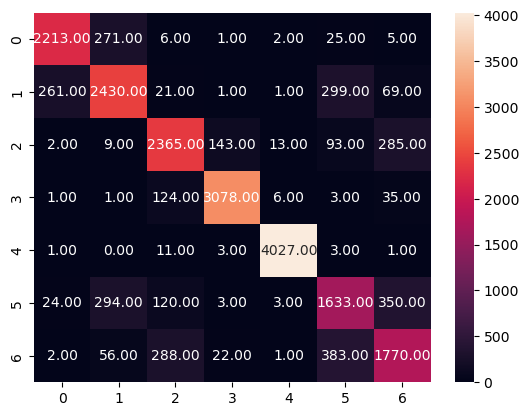

In [40]:
cm = confusion_matrix(df_y, y_train_predict)
sns.heatmap(cm, annot=True,fmt=".2f")
plt.show()

In [125]:
feature_importance = lgb.feature_importances_
sorted_indices = feature_importance.argsort()[::-1]
sorted_feature_names = feature_names[sorted_indices]
sorted_importances = feature_importance[sorted_indices]
sorted_importances

array([17331, 15533, 14556, 10294,  8639,  8223,  3994,  3259,  2233,
        2066,  2038,  2008,  1902,  1793,  1690,  1687,  1618,  1523,
        1508,  1388,  1379,  1340,  1330,  1305,  1178,  1172,  1103,
        1089,  1068,   903,   776,   741,   716,   705,   577,   557,
         429,   402,   294,   285,   272,   211,   147,   143,    15,
           5,     0])

In [110]:
top_10_importances = sorted_importances[:10]          # select the most 20 important features
top_10_feature_names = sorted_feature_names[:10]

<Axes: >

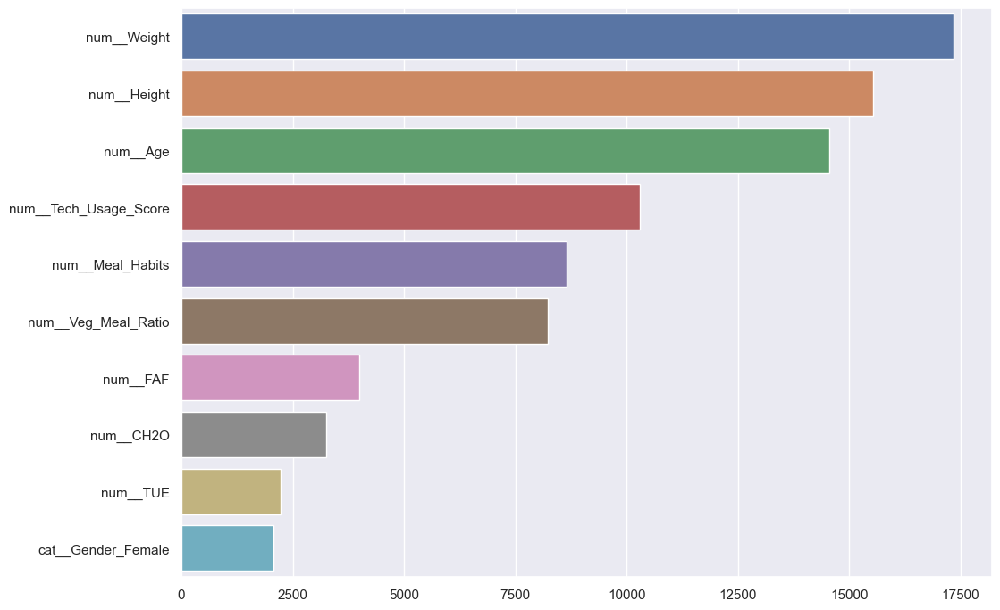

In [111]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(x = top_10_importances,y = top_10_feature_names)

## Pipeline 

In [128]:
class FeaturesExtractor(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.__cols = ['Gender', 'Age', 'Height', 'Weight', 'family_history_with_overweight', 'FAVC', 'FCVC', 'NCP', 'CAEC',
                       'SMOKE', 'CH2O', 'SCC', 'FAF', 'TUE', 'CALC', 'MTRANS']

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X_ = X.copy()
        # BMI category
        X_['BMI_cat'] = X_.apply(BMI_cat, axis=1)
        # Activity
        X_['Activity'] = ['low' if i in ['Public_Transportation', 'Automobile', 'Motorbike'] else 'High' for i in X_['MTRANS']]
        # Meal Habits
        X_['Meal_Habits'] = X_['FCVC'] * X_['NCP']
        X_['Veg_Meal_Ratio'] = X_['FCVC'] / X_['NCP']

        # Tech Usage Score
        X_['Tech_Usage_Score'] = X_['TUE'] / X_['Age']

        bins = [14, 18, 25, 35, 45, 61]
        labels = ['Teenagers', 'Young Adults', 'Adults', 'Middle-aged', 'Senior Adults']
        X_['age_categories'] = pd.cut(X_['Age'], bins=bins, labels=labels,right=False)
        X_['age_categories'] = X_['age_categories'].astype(str)

        X_[['NCP', 'CH2O', 'TUE', 'FAF']] = round(X_[['NCP', 'CH2O', 'TUE', 'FAF']]).astype('int')

        X_= X_.drop(columns=['id'])

        return X_

In [130]:
class CustomOneHotEncoder(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None): 
        self.ohe = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
        self.ohe.fit(X[X.select_dtypes('object').columns])
        return self

    def transform(self, X):
        X_ = X.copy()
        X_[self.ohe.get_feature_names_out()] = self.ohe.transform(X_[X_.select_dtypes('object').columns])
        X_.drop(columns=X.select_dtypes('object').columns, inplace=True)
        
        return X_
    


num_cols_pipeline = Pipeline(
    [
        ('n_nulls', SimpleImputer(strategy='median').set_output(transform="pandas")),  # Impute missing values
    ]
)



cat_cols_pipeline = Pipeline(
    [
        ('c_nulls', SimpleImputer(strategy='most_frequent').set_output(transform="pandas")),  # Impute missing values
        ('ohe', CustomOneHotEncoder())  # One-hot encode categorical features
    ]
)



cat_columns= ['Gender', 'family_history_with_overweight', 'FAVC', 'CAEC', 'SMOKE',
                'SCC', 'CALC', 'MTRANS','age_categories','Activity','BMI_cat']

num_columns = ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE','Meal_Habits','Veg_Meal_Ratio','Tech_Usage_Score']

col_transformer = ColumnTransformer(
    [
        ('num', num_cols_pipeline, num_columns),  # Apply numerical pipeline to numerical columns
        ('cat', cat_cols_pipeline, cat_columns),  # Apply categorical pipeline to categorical columns
    ]
)
full_pipeline = Pipeline(
    [
        ('features_pipeline', FeaturesExtractor()),  # Feature engineering pipeline
        ('preprocessing', col_transformer),  # Preprocessing pipeline
        ('scaler', StandardScaler()),  # Standardize features
        ('model',LGBMClassifier(**para))  # Fit DecisionTreeClassifier
    ]
)

df_final = train.drop('NObeyesdad',axis=1)
full_pipeline.fit(df_final ,df_y)

[LightGBM] [Warning] lambda_l1 is set=0.009538582694471926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009538582694471926
[LightGBM] [Warning] lambda_l2 is set=0.04492742188647295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04492742188647295
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] lambda_l1 is set=0.009538582694471926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009538582694471926
[LightGBM] [Warning] lambda_l2 is set=0.04492742188647295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04492742188647295
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003236 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you

Pipeline(steps=[('features_pipeline', FeaturesExtractor()),
                ('preprocessing',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('n_nulls',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['Age', 'Height', 'Weight',
                                                   'FCVC', 'NCP', 'CH2O', 'FAF',
                                                   'TUE', 'Meal_Habits',
                                                   'Veg_Meal_Ratio',
                                                   'Tech_Usage_Score']),
                                                 ('cat',
                                                  Pipeline(steps=[('c_nulls',
                                                                   SimpleImputer(strategy='most_f...
                                                   'FAVC', 'CAEC', 'SMOKE',
                                                   'SCC', 'CALC', 'MTRANS',
                                                   'age_categories', 'Activity',
                                                   'BMI_cat'])])),
                ('scaler', StandardScaler()),
                ('model',
                 LGBMClassifier(colsample_bytree=0.38021771373288876,
                                lambda_l1=0.009538582694471926,
                                lambda_l2=0.04492742188647295,
                                learning_rate=0.011060225742558435, max_depth=9,
                                min_child_samples=32, n_estimators=594,
                                random_state=42,
                                subsample=0.9824977834004757))])

In [145]:
predictions = cross_val_predict(full_pipeline, df_final, df_y, cv=5)
print("precision_score :",precision_score(df_y,predictions,average='micro'))
print("f1_score :",f1_score(df_y,predictions,average='micro'))

[LightGBM] [Warning] lambda_l1 is set=0.009538582694471926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009538582694471926
[LightGBM] [Warning] lambda_l2 is set=0.04492742188647295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04492742188647295
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] lambda_l1 is set=0.009538582694471926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009538582694471926
[LightGBM] [Warning] lambda_l2 is set=0.04492742188647295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04492742188647295
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002712 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you

------------------

# `06` Generalization Error

In [146]:
label2 =LabelEncoder()
df_y=label2.fit_transform(train['NObeyesdad'])

In [147]:
y_pred = full_pipeline.predict (test)
inv = label2.inverse_transform(y_pred)
inv

[LightGBM] [Warning] lambda_l1 is set=0.009538582694471926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.009538582694471926
[LightGBM] [Warning] lambda_l2 is set=0.04492742188647295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04492742188647295
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


array(['Obesity_Type_II', 'Overweight_Level_I', 'Obesity_Type_III', ...,
       'Insufficient_Weight', 'Normal_Weight', 'Obesity_Type_II'],
      dtype=object)

In [148]:
id = test['id']
df_supm = pd.DataFrame({'id': id , 'NObeyesdad': inv})
df_supm.to_csv('submission.csv',index=False)

In [149]:
df_supm

,id,NObeyesdad
0,20758,Obesity_Type_II
1,20759,Overweight_Level_I
2,20760,Obesity_Type_III
3,20761,Obesity_Type_I
4,20762,Obesity_Type_III
...,...,...
13835,34593,Overweight_Level_II
13836,34594,Normal_Weight
13837,34595,Insufficient_Weight
13838,34596,Normal_Weight


# THANK YOU